**Toy examples**

In this part of the practical session, you will play with some toy data to better understand the classification algorithms seen this morning.

Please answer all questions 

**Deadline**: Upload this notebook, the one about Emotion Recognition and the answers to the theoretical questions to E-Campus. Please verify the exact deadline on E-Campus.

Let's first load the needed packages.

In [1]:
import numpy as np
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt  # for plots
from matplotlib.colors import ListedColormap
from matplotlib import rc

import seaborn as sns
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, accuracy_score
import time

%matplotlib inline
np.random.seed(seed=666)

Here, we define some functions useful for generating and plotting the data

In [2]:
def gaussian_data_generation(n, mean, cov, noise_std):
   # create data which follows a multivariate Gaussian distribution
   # a white (Gaussian) noise is then added to the data
    
    assert cov.shape[0] == cov.shape[1], "Please use only square covariance matrix"    
    assert len(mean) == cov.shape[0], "the dimension of the mean should be equal to the dimension of the covariance matrix"
    
    X = np.random.multivariate_normal(mean, cov, n) # actual data
    X = X + np.random.multivariate_normal(np.zeros(len(mean)), noise_std ** 2 *np.eye(len(mean)), n)  # we add white noise to the data     
   
    return X

def frontiere(f, X, y, step=50):
    # decision boundary of classifier f
    # construct cmap

    min_tot = np.min(X)
    max_tot = np.max(X)
    delta = (max_tot - min_tot) / step
    xx, yy = np.meshgrid(np.arange(min_tot, max_tot, delta),
                         np.arange(min_tot, max_tot, delta))
    z = np.array([f(vec) for vec in np.c_[xx.ravel(), yy.ravel()]])
    z = z.reshape(xx.shape)
    labels = np.unique(z)
    color_blind_list = sns.color_palette("colorblind", labels.shape[0])
    sns.set_palette(color_blind_list)
    my_cmap = ListedColormap(color_blind_list)
    plt.imshow(z, origin='lower', extent=[min_tot, max_tot, min_tot, max_tot],
               interpolation="mitchell", alpha=0.80, cmap=my_cmap)

    ax = plt.gca()
    cbar = plt.colorbar(ticks=labels)
    cbar.ax.set_yticklabels(labels)

    k = np.unique(y).shape[0]
    color_blind_list = sns.color_palette("colorblind", k)
    for i, label in enumerate(y):
        plt.scatter(X[i, 0], X[i, 1], c=[color_blind_list[int(y[i])]],
                    s=80, marker=symlist[int(label)])
    plt.ylim([min_tot, max_tot])
    plt.xlim([min_tot, max_tot])
    ax.get_yaxis().set_ticks([])
    ax.get_xaxis().set_ticks([])
    
def class_int_round(z, n_class):
    # rounding needed to go from real to integer values 
    output = np.round(z).astype(int)
    if isinstance(z, np.ndarray):
        j = z < 0
        output[j] = 0
        k = z > n_class - 1
        output[k] = n_class - 1
    else:
        if output < 0:
            output = 0
        else:
            if output > n_class - 1:
                output = n_class - 1
    return output

The next function is the one you will use to crete the toy data. You can choose among three scenarios: 2, 3 or 4 classes. Each class is composed of 2D points sampled from a multivariate Gaussian distribution. You can choose the number of samples, average and covariance matrix for each class. 

In [3]:
def generate_scenario(n_classes=3):
    
    if n_classes == 2:
        # Example with 2 classes
        n_0=80
        mean_0 = [0, 0]        
        cov_0 = np.array([[1, 0.1], [0.1, 0.9]])
        X_0=gaussian_data_generation(n_0, mean_0, cov_0, 0.1)
        y_0=np.zeros(n_0)
        
        n_1=80
        mean_1 = [3, 2]
        cov_1 = np.array([[0.1, 0], [0, 0.5]])
        X_1=gaussian_data_generation(n_1, mean_1, cov_1, 0.1)
        y_1=np.ones(n_1)
        
        X=np.concatenate((X_0,X_1))
        y=np.concatenate((y_0,y_1))
        
    elif n_classes == 3:
        # Example with 3 classes
        n_0=80
        mean_0 = [0, 0]        
        cov_0 = np.array([[1, 0.1], [0.1, 0.9]])
        X_0=gaussian_data_generation(n_0, mean_0, cov_0, 0.1)
        y_0=np.zeros(n_0)
        
        n_1=80
        mean_1 = [2, 2]
        cov_1 = np.array([[0.1, 0], [0, 0.5]])
        X_1=gaussian_data_generation(n_1, mean_1, cov_1, 0.1)
        y_1=np.ones(n_1)
        
        n_2=80
        mean_2 = [3, 3]
        cov_2 = np.array([[0.5, 0.1], [0.1, 1]])
        X_2=gaussian_data_generation(n_2, mean_2, cov_2, 0.1)
        y_2=2*np.ones(n_2)
        
        X=np.concatenate((X_0,X_1,X_2))
        y=np.concatenate((y_0,y_1,y_2))
    elif n_classes == 4:
        # Example with 4 classes
        n_0=80
        mean_0 = [0, 0]        
        cov_0 = np.array([[1, 0.1], [0.1, 0.9]])
        X_0=gaussian_data_generation(n_0, mean_0, cov_0, 0.1)
        y_0=np.zeros(n_0)
        
        n_1=80
        mean_1 = [3, 3]
        cov_1 = np.array([[0.1, 0], [0, 0.5]])
        X_1=gaussian_data_generation(n_1, mean_1, cov_1, 0.1)
        y_1=np.ones(n_1)
        
        n_2=80
        mean_2 = [0, 3]
        cov_2 = np.array([[0.5, 0.1], [0.1, 1]])
        X_2=gaussian_data_generation(n_2, mean_2, cov_2, 0.1)
        y_2=2*np.ones(n_2)
        
        n_3=80
        mean_3 = [3, 0]
        cov_3 = np.array([[0.9, 0.15], [0.15, 0.8]])
        X_3=gaussian_data_generation(n_3, mean_3, cov_3, 0.1)
        y_3=3*np.ones(n_3)
        
        X=np.concatenate((X_0,X_1,X_2,X_3))
        y=np.concatenate((y_0,y_1,y_2,y_3))  

    return X, y

Let's choose a scenario and generate some data

In [4]:
######## PARAMETER TO CHOOSE THE SCENARIO (number of classes) #######
n_classes = 3
#####################################################################

X, y = generate_scenario(n_classes)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

Let's plot the data

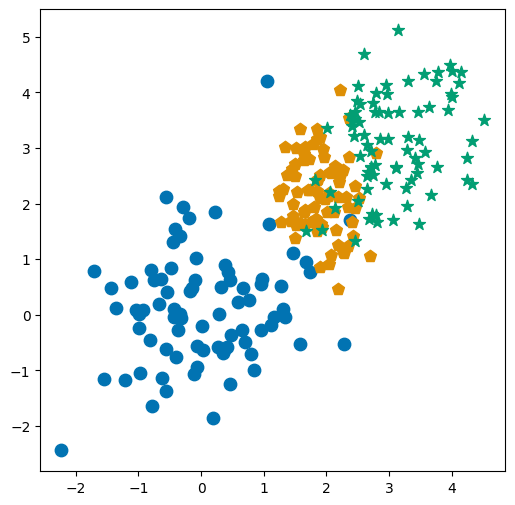

In [5]:
fig1 = plt.figure(figsize=(6, 6))
ax = plt.gca()
min_tot = np.min(X)
max_tot = np.max(X)
symlist = ['o', 'p', '*', 's', '+', 'x', 'D', 'v', '-', '^']
k = np.unique(y).shape[0]
color_blind_list = sns.color_palette("colorblind", k)
for i, label in enumerate(y):
    plt.scatter(X[i, 0], X[i, 1], c=[color_blind_list[int(y[i])]],
                s=80, marker=symlist[int(label)])
#ax.get_yaxis().set_ticks([])
#ax.get_xaxis().set_ticks([])

As first classifier, we can use a simple linear regression where we  transform in integers the predictions.

 **Question**: look at the function 'class_int_round'. Explain what it does.

The function `class_int_round` is designed to transform the continuous output of a model, such as the predictions from linear regression, into discrete integer values that represent different classes in a classification context. This transformation is necessary because linear regression inherently produces continuous outputs, but for classification tasks, especially those involving categorical outcomes, we need discrete class labels.

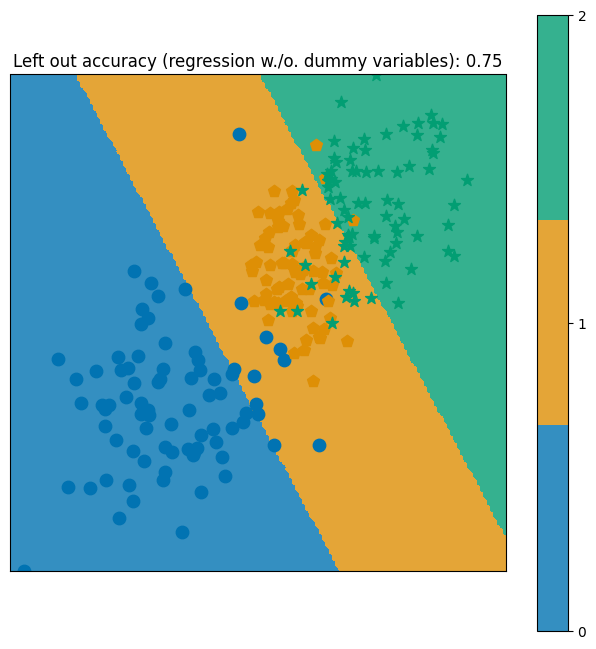

In [15]:
##############################################################################
# Naive linear regression on raw observations
##############################################################################

resolution_param = 150  # 500 for nice plotting, 50 for fast version
regr = LinearRegression()
regr.fit(X_train, y_train)
y_pred_test = class_int_round(regr.predict(X_test), n_classes)

# Plotting part
fig0 = plt.figure(figsize=(8, 8))
title = "Left out accuracy (regression w./o. dummy variables)" + \
        ": {:.2f}".format(accuracy_score(y_test, y_pred_test))
plt.title(title)

def f(xx):
    """Classifier"""
    return class_int_round(regr.predict(xx.reshape(1, -1)), n_classes)
frontiere(f, X, y, step=resolution_param)

plt.show()

Instead of using this simple strategy, we can also use a *OneHotEncoder*.

**Question**: Do you see any difference in the resulting decision boundaries ? Which is the best strategy in your opinion ? Why ?

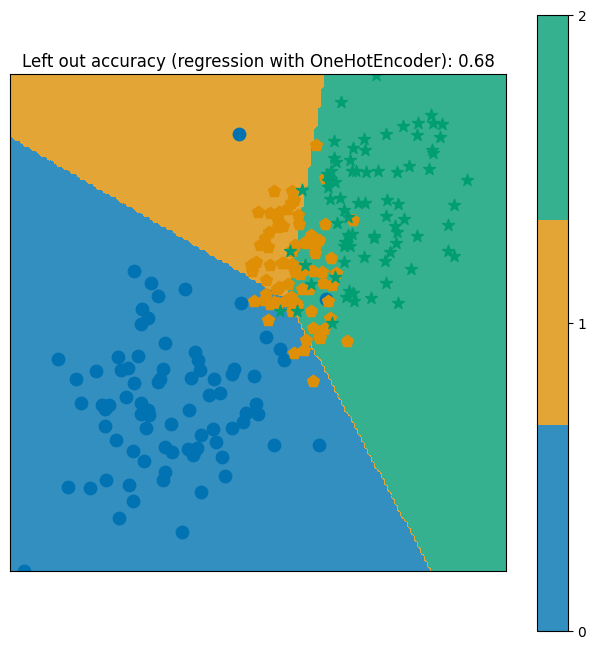

In [16]:
##############################################################################
# Naive linear regression on dummy variables (OneHotEncoder)
##############################################################################
resolution_param = 150  
enc = OneHotEncoder(categories='auto')
enc.fit(y_train.reshape(-1, 1))
Y = enc.transform(y_train.reshape(-1, 1)).toarray()
regr_multi = LinearRegression()
regr_multi.fit(X_train, Y)
proba_vector_test = regr_multi.predict(X_test)
y_pred_test = class_int_round(regr.predict(X_test), n_classes)

# performance evaluation on new dataset
y_pred_test = np.argmax(proba_vector_test, axis=1)
title = "Left out accuracy (regression with OneHotEncoder)" + \
        ": {:.2f}".format(accuracy_score(y_test, y_pred_test))

# Plotting part
fig1 = plt.figure(figsize=(8, 8))
plt.title(title)


def f(xx):
    """Classifier"""
    return np.argmax(regr_multi.predict(xx.reshape(1, -1)))
frontiere(f, X, y, step=resolution_param)

plt.show()

Let's use the other strategies seen this morning.

C:\Users\danie\AppData\Local\Temp\ipykernel_16412\676083778.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf.predict(xx.reshape(1, -1)))
C:\Users\danie\AppData\Local\Temp\ipykernel_16412\676083778.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf.predict(xx.reshape(1, -1)))
C:\Users\danie\AppData\Local\Temp\ipykernel_16412\676083778.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf.predict(xx.reshape(1, -1)))
C

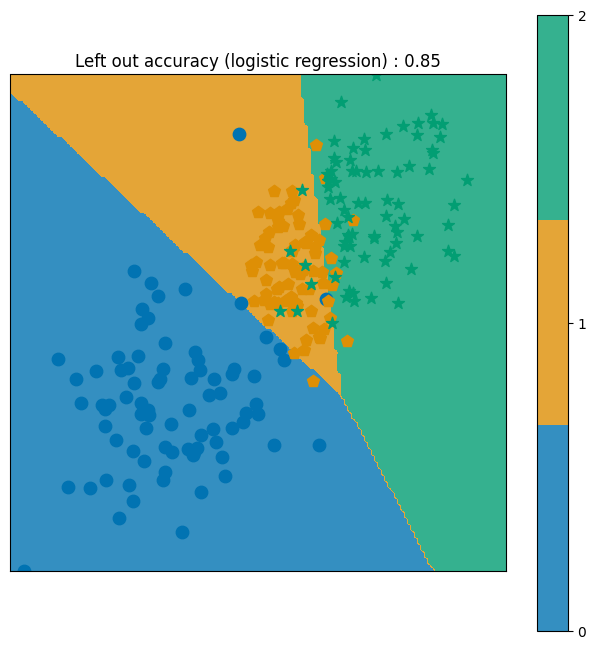

In [17]:
##############################################################################
# Logistic regression
##############################################################################
resolution_param = 150  
clf = LogisticRegression(solver='lbfgs',multi_class='ovr') # you can also try multi_class='multinomial', 
clf.fit(X_train, y_train)
y_logit_test = clf.predict(X_test)
title = "Left out accuracy (logistic regression) " + \
        ": {:.2f}".format(accuracy_score(y_test, y_logit_test))
fig2 = plt.figure(figsize=(8, 8))
plt.title(title)


def f(xx):
    """Classifier"""
    return int(clf.predict(xx.reshape(1, -1)))
frontiere(f, X, y, step=resolution_param)

plt.show()

C:\Users\danie\AppData\Local\Temp\ipykernel_16412\3415257437.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_LDA.predict(xx.reshape(1, -1)))
C:\Users\danie\AppData\Local\Temp\ipykernel_16412\3415257437.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_LDA.predict(xx.reshape(1, -1)))
C:\Users\danie\AppData\Local\Temp\ipykernel_16412\3415257437.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_LDA.predict(xx.res

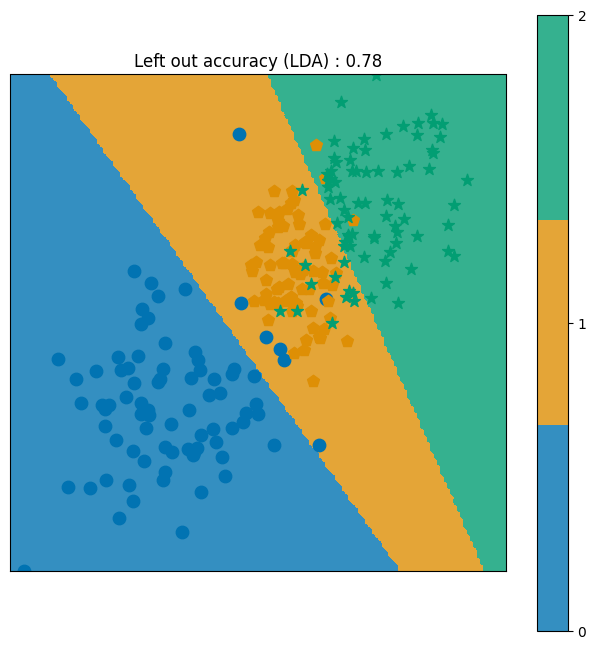

In [18]:
##############################################################################
# LDA
##############################################################################
resolution_param = 150  
clf_LDA = LinearDiscriminantAnalysis()
clf_LDA.fit(X_train, y_train)
y_LDA_test = clf_LDA.predict(X_test)

title = "Left out accuracy (LDA) " + \
        ": {:.2f}".format(accuracy_score(y_test, y_LDA_test))
fig2 = plt.figure(figsize=(8, 8))
plt.title(title)


def f(xx):
    """Classifier"""
    return int(clf_LDA.predict(xx.reshape(1, -1)))
frontiere(f, X, y, step=resolution_param)

plt.show()

C:\Users\danie\AppData\Local\Temp\ipykernel_16412\4125389115.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_QDA.predict(xx.reshape(1, -1)))
C:\Users\danie\AppData\Local\Temp\ipykernel_16412\4125389115.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_QDA.predict(xx.reshape(1, -1)))
C:\Users\danie\AppData\Local\Temp\ipykernel_16412\4125389115.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_QDA.predict(xx.res

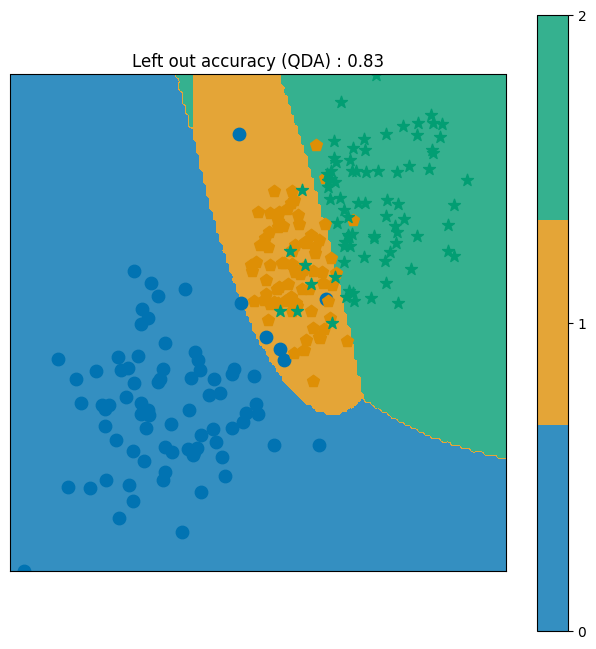

In [19]:
##############################################################################
# QDA
##############################################################################
resolution_param = 150 
clf_QDA = QuadraticDiscriminantAnalysis()
clf_QDA.fit(X_train, y_train)
y_QDA_test = clf_QDA.predict(X_test)
title = "Left out accuracy (QDA) " + \
        ": {:.2f}".format(accuracy_score(y_test, y_QDA_test))
fig2 = plt.figure(figsize=(8, 8))
plt.title(title)


def f(xx):
    """Classifier"""
    return int(clf_QDA.predict(xx.reshape(1, -1)))
frontiere(f, X, y, step=resolution_param)

plt.show()

C:\Users\danie\AppData\Local\Temp\ipykernel_16412\3075597501.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_GNB.predict(xx.reshape(1, -1)))
C:\Users\danie\AppData\Local\Temp\ipykernel_16412\3075597501.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_GNB.predict(xx.reshape(1, -1)))
C:\Users\danie\AppData\Local\Temp\ipykernel_16412\3075597501.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_GNB.predict(xx.res

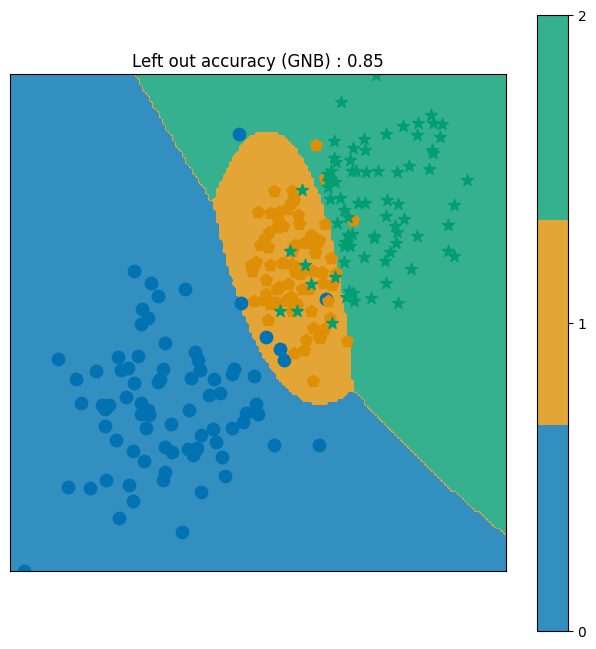

In [20]:
##############################################################################
# Naive Bayes 
##############################################################################
resolution_param = 150  
clf_GNB = GaussianNB()
clf_GNB.fit(X_train, y_train)

y_test_GNB = clf_GNB.predict(X_test)

title = "Left out accuracy (GNB) " + \
        ": {:.2f}".format(accuracy_score(y_test, y_test_GNB))
fig2 = plt.figure(figsize=(8, 8))
plt.title(title)


def f(xx):
    """Classifier"""
    return int(clf_GNB.predict(xx.reshape(1, -1)))
frontiere(f, X, y, step=resolution_param)

plt.show()

C:\Users\danie\AppData\Local\Temp\ipykernel_16412\1804556473.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_KNN.predict(xx.reshape(1, -1)))
C:\Users\danie\AppData\Local\Temp\ipykernel_16412\1804556473.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_KNN.predict(xx.reshape(1, -1)))
C:\Users\danie\AppData\Local\Temp\ipykernel_16412\1804556473.py:18: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return int(clf_KNN.predict(xx.res

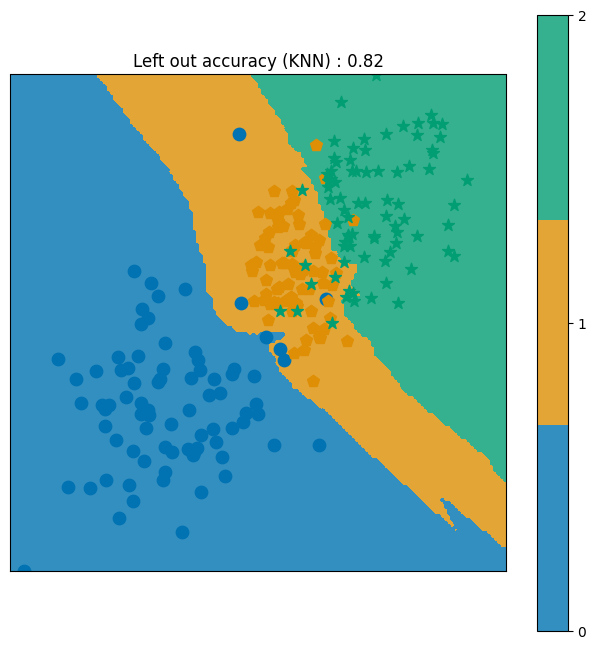

In [21]:
##############################################################################
# KNN
##############################################################################
resolution_param = 150  
clf_KNN = KNeighborsClassifier()
clf_KNN.n_neighbors=5

clf_KNN.fit(X_train, y_train)
y_KNN_test = clf_KNN.predict(X_test)

title = "Left out accuracy (KNN) " + \
        ": {:.2f}".format(accuracy_score(y_test, y_KNN_test))
fig2 = plt.figure(figsize=(8, 8))
plt.title(title)

def f(xx):
    """Classifier"""
    return int(clf_KNN.predict(xx.reshape(1, -1)))
frontiere(f, X, y, step=resolution_param)

plt.show()

**Questions**:


*   Describe the decision boundaries of the methods. Are all linear ?
*   Using the following code, compare the computational time and the test accuracy of the different methods in the three scenarios. Comment the results.
* (Optional) If you change the number of samples per class (both training and test), do the results vary ?



## Clasification Algorithms 

Below, we explore several commonly used classification methods, outlining how they work, the nature of their decision boundaries, and their pros and cons.

### 1. Naive Linear Regression on Raw Observations

- **How It Works**: Linear regression models the relationship between a dependent variable and one or more independent variables using a linear equation. In a naive application on raw observations for classification, the continuous output is directly used to make class predictions, often by setting thresholds.
- **Nature of the Boundaries**: The decision boundaries are linear.
- **Advantages**: Simple and easy to understand; provides continuous output that can be interpreted in terms of the effect size of predictors.
- **Disadvantages**: Assumes a linear relationship; not naturally suited for classification tasks as it doesn't output probabilities for class membership.

### 2. Naive Linear Regression on Dummy Variables (OneHotEncoder)

- **How It Works**: This approach involves transforming categorical output into multiple binary variables (dummy variables) and then applying linear regression separately to each. Predictions are often made by selecting the class corresponding to the highest regression output.
- **Nature of the Boundaries**: Linear decision boundaries.
- **Advantages**: Allows linear regression to be used for multi-class classification problems.
- **Disadvantages**: Increases model complexity with more classes; still does not naturally handle class probabilities.

### 3. Logistic Regression

- **How It Works**: Logistic regression models the probabilities of default categories (binary/multinomial outcomes) by applying a logistic function to the linear regression output. This ensures the output lies between 0 and 1, interpretable as probabilities.
- **Nature of the Boundaries**: Linear decision boundaries.
- **Advantages**: Outputs probabilities for class membership; directly applicable to binary and multinomial classification.
- **Disadvantages**: Assumes a linear decision boundary; performance can decline with very non-linear data relationships.

### 4. Linear Discriminant Analysis (LDA)

- **How It Works**: LDA assumes that different classes generate data based on different Gaussian distributions. It finds a linear combination of features that best separates the classes.
- **Nature of the Boundaries**: Linear decision boundaries.
- **Advantages**: Takes into account the mean and variance of each class; useful for dimensionality reduction.
- **Disadvantages**: Assumes Gaussian distribution of the data and that all classes share the same covariance matrix.

### 5. Quadratic Discriminant Analysis (QDA)

- **How It Works**: Similar to LDA, but allows each class to have its own covariance matrix, leading to quadratic decision boundaries.
- **Nature of the Boundaries**: Quadratic decision boundaries.
- **Advantages**: More flexible than LDA, can model more complex relationships.
- **Disadvantages**: Requires estimating more parameters, which can be a disadvantage with limited data.

### 6. Naive Bayes

- **How It Works**: Based on Bayes’ theorem, it assumes independence among predictors. Naive Bayes classifier calculates the probability of each class and the conditional probability of each class given each input value. These probabilities are then used to make a prediction.
- **Nature of the Boundaries**: Can be linear or non-linear, depending on the data distribution.
- **Advantages**: Simple, fast, and effective; works well with high-dimensional data.
- **Disadvantages**: Assumes independence of all predictors, which often isn’t the case (naive assumption).

### 7. K-Nearest Neighbors (KNN)

- **How It Works**: Classifies a data point based on how its neighbors are classified. KNN assigns the class more common among its k nearest neighbors.
- **Nature of the Boundaries**: Can be very complex, non-linear.
- **Advantages**: Simple and effective; no assumptions about the data distribution.
- **Disadvantages**: Computationally expensive as the dataset grows; performance depends heavily on the choice of k and the distance metric.

Method: GaussianNB
Computational time: 0.00360 s
Test accuracy: 0.850

Method: KNeighborsClassifier
Computational time: 0.01139 s
Test accuracy: 0.817

Method: LinearDiscriminantAnalysis
Computational time: 0.00359 s
Test accuracy: 0.783

Method: LinearRegression
Computational time: 0.00171 s
Test accuracy: 0.717

Method: LogisticRegression
Computational time: 0.00750 s
Test accuracy: 0.850

Method: QuadraticDiscriminantAnalysis
Computational time: 0.00102 s
Test accuracy: 0.833



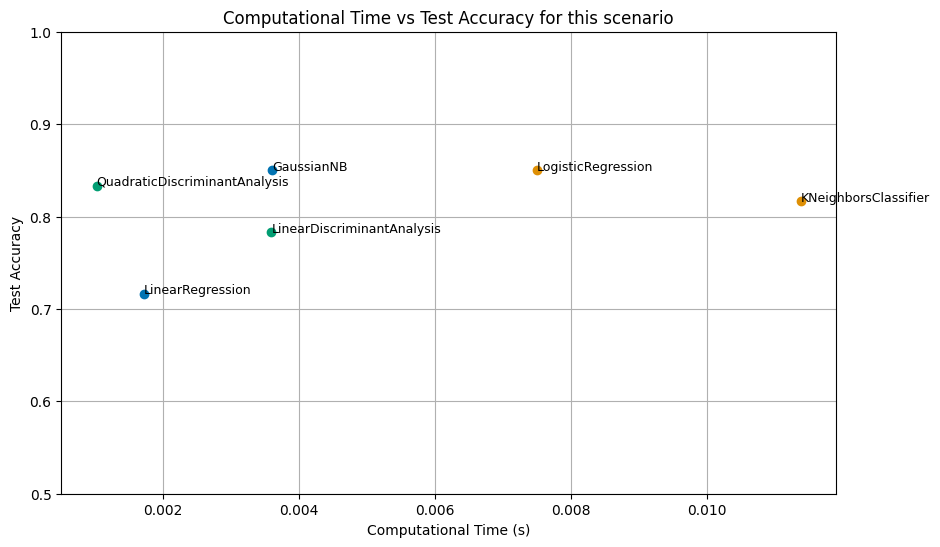

In [39]:
# Defining the methods
methods = {
    'GaussianNB': clf_GNB,
    'KNeighborsClassifier': clf_KNN,
    'LinearDiscriminantAnalysis': clf_LDA,
    'LinearRegression': regr,
    'LogisticRegression': clf,
    'QuadraticDiscriminantAnalysis': clf_QDA
}

results = {'Method': [], 'Computational Time (s)': [], 'Test Accuracy': []}

# Iterating over the methods
for method_name, method in methods.items():
    
    time_start = time.perf_counter()
    
    # Fitting the model and make predictions
    method.fit(X_train, y_train)
    y_test_pred = method.predict(X_test)
    
    # Rounding the predictions if the method is LinearRegression
    if method_name == 'LinearRegression':  
        y_test_pred = np.round(y_test_pred).astype(int)
    
    # Calculating the computational time and accuracy score
    time_elapsed = time.perf_counter() - time_start
    accuracy = accuracy_score(y_test, y_test_pred)
    
    # Storing results
    results['Method'].append(method_name)
    results['Computational Time (s)'].append(time_elapsed)
    results['Test Accuracy'].append(accuracy)
    
    # Printing the results
    print(f"Method: {method_name}")
    print(f"Computational time: {time_elapsed:.5f} s")
    print(f"Test accuracy: {accuracy:.3f}")
    print()

# Plotting
plt.figure(figsize=(10, 6))
for i, method in enumerate(results['Method']):
    plt.scatter(results['Computational Time (s)'][i], results['Test Accuracy'][i])
    plt.text(results['Computational Time (s)'][i], results['Test Accuracy'][i], method, fontsize=9)

# Limits
plt.ylim([0.5, 1])

plt.xlabel('Computational Time (s)')
plt.ylabel('Test Accuracy')
plt.title('Computational Time vs Test Accuracy for this scenario')
plt.grid(True)
plt.show()

The results seems coherent within the typical performances for these methods on classification tasks.

- **GaussianNB (Naive Bayes)** and **LogisticRegression** both showing a test accuracy of 0.850 suggests that both methods are effectively modeling the data. Naive Bayes tends to perform well when the assumption of feature independence holds true, while logistic regression is robust for linearly separable data.

- **KNeighborsClassifier** with an accuracy of 0.817 is also reasonable. KNN's performance is highly dependent on the choice of `k` and the distance metric. It might perform better or worse depending on the specific distribution of the data and the relevance of neighbors to the classification decision.

- **LinearDiscriminantAnalysis (LDA)** having an accuracy of 0.783 indicates it's somewhat effective but might be limited by the assumption that different classes share the same covariance matrix. If this assumption does not hold, it might not capture the full complexity of the data.

- **LinearRegression** showing the lowest accuracy (0.717) is expected. Linear regression is not inherently suited for classification tasks, as it predicts continuous values, not classes. Converting its output to categories, as you've done, usually results in lower accuracy compared to methods specifically designed for classification.

- **QuadraticDiscriminantAnalysis (QDA)** with an accuracy of 0.833 shows it's quite effective, likely because it does not assume equal covariance across classes, allowing it to model more complex relationships than LDA.